In [ ]:
!pip install pinecone-client datasets torch

In [1]:
import pinecone

pinecone.init(
    api_key="<<YOUR_API_KEY>>",
    environment="us-west1-gcp"
)
index = pinecone.Index("imagenet-query-trainer-clip")

In [2]:
from datasets import load_dataset

imagenet = load_dataset(
    'frgfm/imagenette',
    'full_size',
    split='train',
    ignore_verifications=False  # set to True if seeing splits Error
)
imagenet

Reusing dataset imagenette (/Users/jamesbriggs/.cache/huggingface/datasets/frgfm___imagenette/full_size/1.0.0/38929285b8abcae5c1305418e9d8fea5dd6b189bbbd22caba5f5537c7fa0f01f)


Dataset({
    features: ['image', 'label'],
    num_rows: 9469
})

We will start with a generic query, emulating that we don't really know what we're looking for. To create the embedding from that we need to use the natural language part of OpenAI's CLIP.

In [4]:
from transformers import CLIPTokenizerFast, CLIPModel

model_id = "openai/clip-vit-base-patch32"

tokenizer = CLIPTokenizerFast.from_pretrained(model_id)
model = CLIPModel.from_pretrained(model_id)

prompt = "dogs in the snow"

inputs = tokenizer(prompt, return_tensors="pt")
out = model.get_text_features(**inputs)
out.shape

torch.Size([1, 512])

As with our image embeddings, we get a `1, 512` dimension tensor. We perform the same steps to prepare it as a query vector `xq` for Pinecone.

In [5]:
out = out.squeeze(0)
out.shape

torch.Size([512])

In [6]:
import torch

xq = out.cpu().detach().numpy().tolist()
len(xq)

512

We retrieve `10` of the most similar records and store them in `xc`:

In [7]:
xc = index.query(xq, top_k=10, include_values=True)

`xc` contains more than just the vectors, it is a JSON object in the format:

```json
{
    'matches': [
        {
            'id': '<<ID of retrieved item #1>>',
            'score': 0.53,  # float value similarity score
            'values': [-0.22, 0.21, ...],  # the vector embedding itself
        },
        {
            'id': '<<ID of retrieved item #2>>',
            'score': 0.41,
            'values': [-0.19, 0.29, ...],
        },
        ...  # this continues for the 10 records we've returned
    ],
    'namespace': ''
}
```

We don't need all of this information, all we need are the ID values that we will convert to index values for extracting and displaying the images themselves, and the vectors for training the model.

In [8]:
# get the index values
idx = [int(match['id']) for match in xc['matches']]
idx

[5704, 6368, 6031, 6496, 6199, 5833, 6377, 6443, 6155, 5987]

In [9]:
# get the vectors
values = [match['values'] for match in xc['matches']]

Now we can see what these returned images look like.

5704


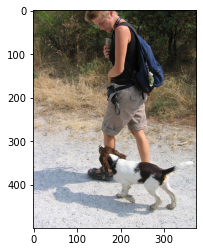

6368


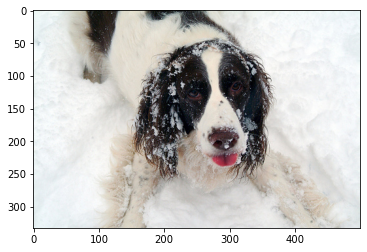

6031


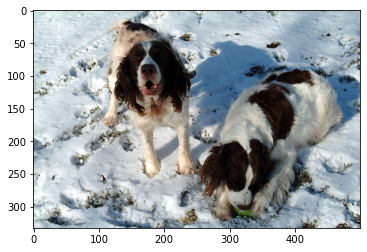

6496


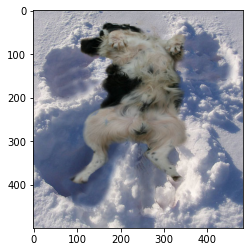

6199


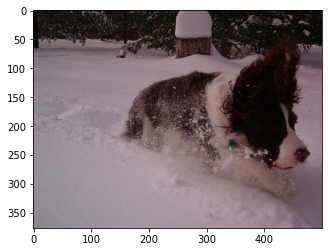

5833


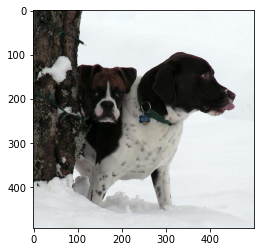

6377


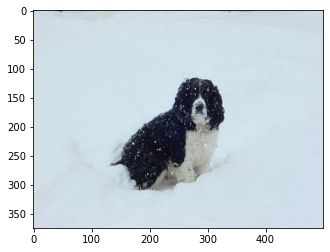

6443


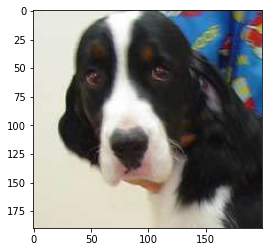

6155


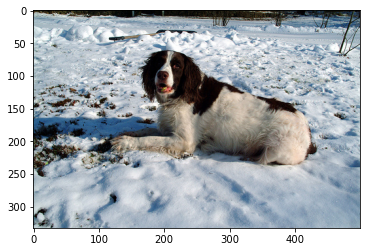

5987


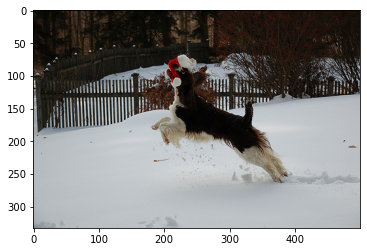

In [10]:
import matplotlib.pyplot as plt

for i in idx:
    print(i)
    plt.imshow(imagenet[i]['image'])
    plt.show()

I want to find the boombox style sony radio from the previous 00-indexer-clip.ipynb notebook TK link. To do that, I need to set radios that I think most resemble that radio as positives, and everything else as negatives.

In [11]:
positives = [6368, 6031, 6496, 6199, 5833, 6377, 6155, 5987]
negatives = [i for i in idx if i not in positives]
print(f"Positives: {positives}\nNegatives: {negatives}")

Positives: [6368, 6031, 6496, 6199, 5833, 6377, 6155, 5987]
Negatives: [5704, 6443]


Now we extract the vector values extracted from Pinecone during the `query`, and prepare both these input values `X` and also some target labels `y`. We will use these to train our linear classifier.

In [12]:
# we need to extract the embeddings of the positives and negatives
positives = [
    match['values'] for match in xc['matches'] if int(match['id']) in positives
]
negatives = [
    match['values'] for match in xc['matches'] if int(match['id']) in negatives
]

In [13]:
# create the training inputs
X = positives + negatives
len(X)

10

We only have two labels, `0` for irrelevant, and `1` for relevant.

In [14]:
# and create our labels (in this case only zeros)
y = [1] * len(positives) + [0] * len(negatives)
y  # these are our target labels

[1, 1, 1, 1, 1, 1, 1, 1, 0, 0]

We will use a linear classifier model to learn the "perfect query" based on our selections. For this we will use a linear layer from PyTorch, find [install instructions for PyTorch here](https://pytorch.org), or just do following (not recommended):

```
!pip install torch
```

In [15]:
import torch

# initialize the model with 512 input size and one output
model = torch.nn.Linear(512, 1)

# convert previous query `xq` to tensor paramater for initial model weights
init_weight = torch.Tensor(xq).reshape(1, -1)
model.weight = torch.nn.Parameter(init_weight)

# init loss and optimizer
loss = torch.nn.BCEWithLogitsLoss()
optimizer = torch.optim.SGD(model.parameters(), lr=0.2)

Now we have our model and first training batch ready, we can perform a training loop with our classifier, which we will define in a function called `fit`:

In [17]:
model.train()  # switch model to training mode

def fit(X: list, y: list, iters: int = 5):
    for _ in range(iters):
        # get predictions
        out = model(torch.Tensor(X))
        # calculate loss
        loss_value = loss(out, torch.Tensor(y).reshape(-1, 1))
        # reset gradients
        optimizer.zero_grad()
        # backpropagate
        loss_value.backward()
        # update weights
        optimizer.step()

In [18]:
# train
fit(X, y)

Now we extract a new query vector from the model weights:

In [19]:
model.weight.shape

torch.Size([1, 512])

We need to convert this to a flat list for Pinecone:

In [20]:
xq = model.weight.detach().numpy()[0].tolist()

Now before we search again we must mark the already retrieved vectors so that we don't retrieve them again. We do this using metadata filtering in Pinecone.

In [21]:
# we must update one record at a time
for i in idx:
    index.update(str(i), set_metadata={"seen": 1})

Now search using the new query vector.

6573


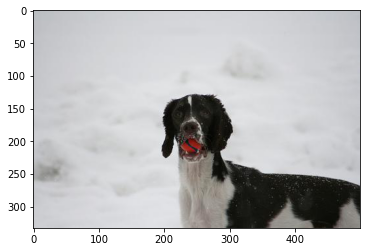

5990


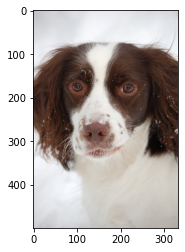

6105


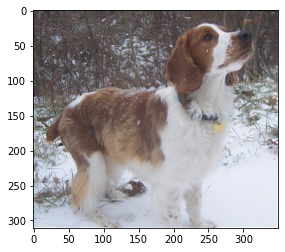

6200


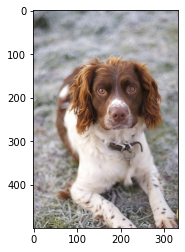

7672


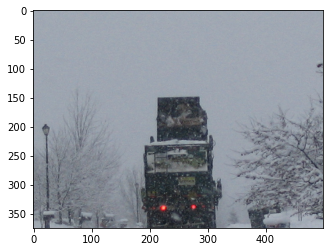

5730


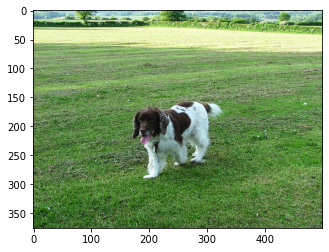

5878


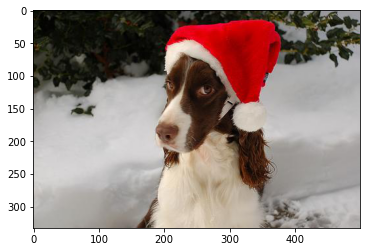

5881


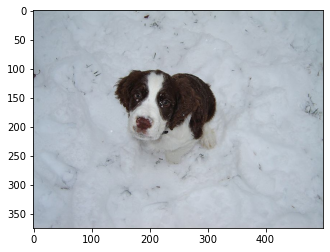

6054


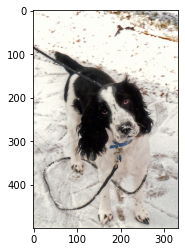

6033


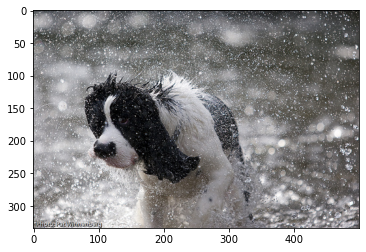

In [22]:
# retrieve most similar records
xc = index.query(
    xq,
    top_k=10,
    include_values=True,
    filter={"seen": 0}
)
# extract index and vector values
idx = [int(match['id']) for match in xc['matches']]
values = [match['values'] for match in xc['matches']]

# visualize the results
for i in idx:
    print(i)
    plt.imshow(imagenet[i]['image'])
    plt.show()

We will need keep iterating through several sets of images before finding the optimal query. So let's clean up our code a little starting with the tuning operation. All we'll do here is place all of the previous logic into a function called `tune`:

In [23]:
def tune(positives, xc, idx, update=True):
    # confirm any positives actually exist
    for i in positives:
        assert i in idx
    # extract positive and negative vectors
    negatives = [i for i in idx if i not in positives]
    positives = [
        match['values'] for match in xc['matches'] if int(match['id']) in positives
    ]
    negatives = [
        match['values'] for match in xc['matches'] if int(match['id']) in negatives
    ]
    # create target labels
    y = [1] * len(positives) + [0] * len(negatives)
    # create training inputs
    X = positives + negatives
    # train
    fit(X, y)
    # extract new query vector
    xq = model.weight.detach().numpy()[0].tolist()
    # and update the "seen" metadata
    if update:
        # we must update one record at a time
        for i in idx:
            index.update(str(i), set_metadata={"seen": 1})
    return xq

Now we update the model and query:

In [24]:
positives = [6573, 6105, 6200, 5878, 5881, 6054, 6033]
xq = tune(positives, xc, idx)

Now we return to retrieving more images. Again, let's collate all of the logic from before into a single `get_top_k` function:

In [25]:
def get_top_k(xq, top_k=10):
    # query the index
    xc = index.query(
        xq,
        top_k=top_k,
        include_values=True,
        filter={"seen": 0}
    )
    # extract IDs and vectors
    idx = [int(match['id']) for match in xc['matches']]
    values = [match['values'] for match in xc['matches']]
    # show retrieved images
    for i in idx:
        print(i)
        plt.imshow(imagenet[i]['image'])
        plt.show()
    return idx, xc

Now we retrieve those records:

2849


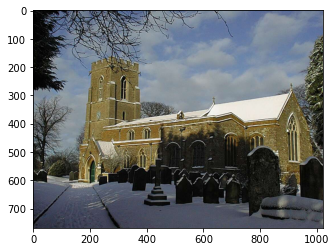

7599


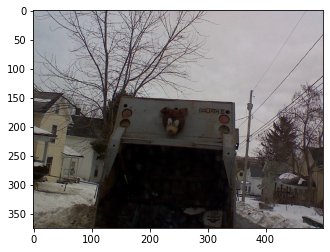

3120


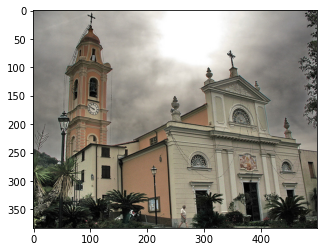

6532


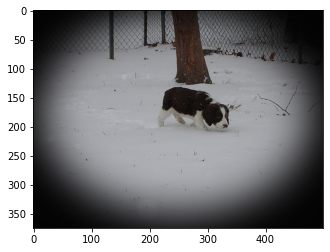

6375


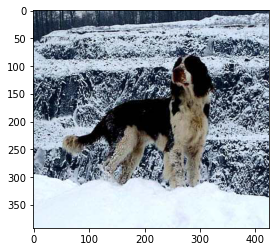

6405


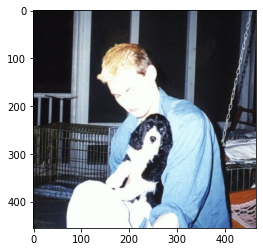

7595


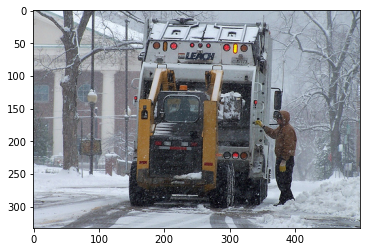

5795


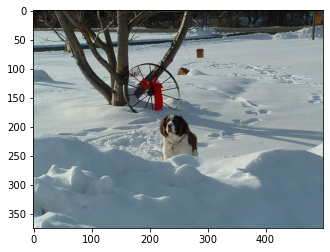

5765


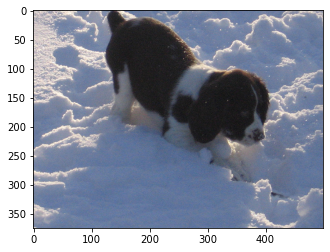

5815


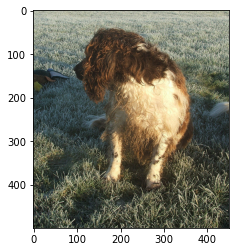

In [26]:
idx, xc = get_top_k(xq)

Again no positives, we need to repeat this process a few times...

5932


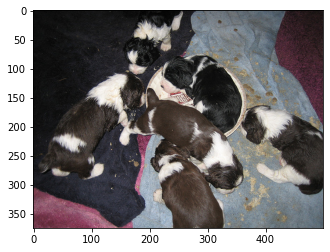

6423


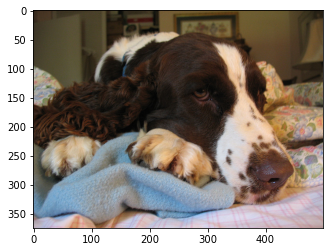

6453


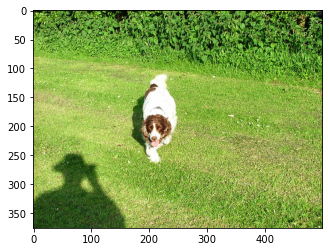

6076


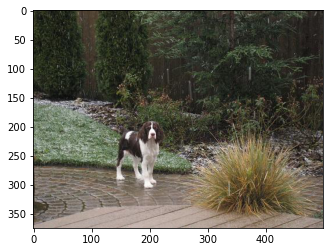

5792


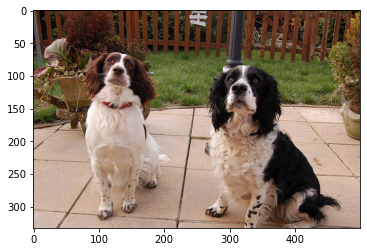

6084


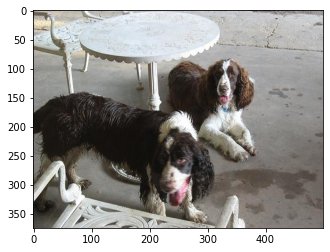

5663


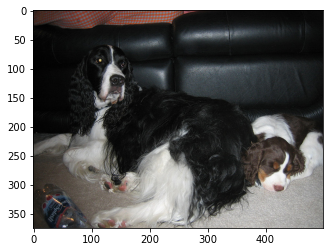

6032


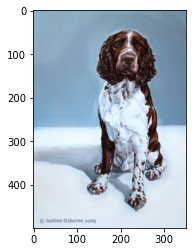

5930


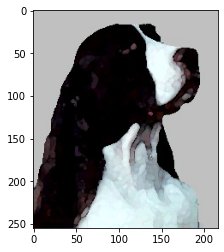

6407


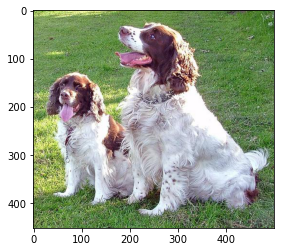

In [27]:
positives = [6532, 6375, 6405, 5795, 5765, 5815]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We now have our first dog images, so we add the `idx` values of these images to the `positives` list and repeat the training process.

3512


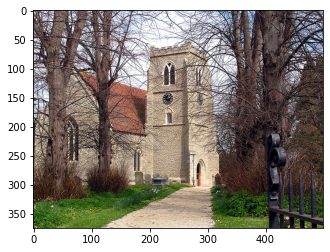

9206


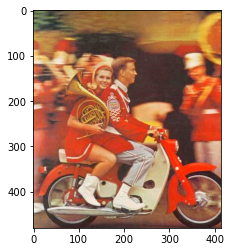

7954


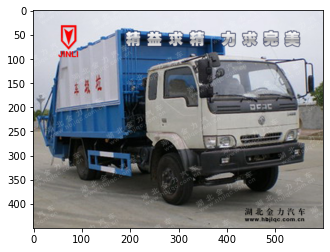

7614


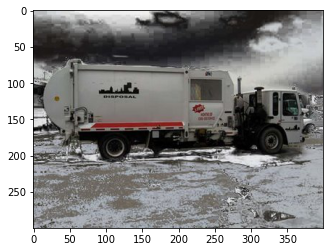

1465


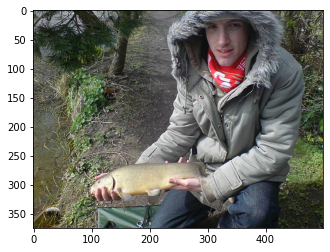

3548


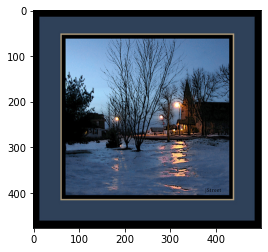

4858


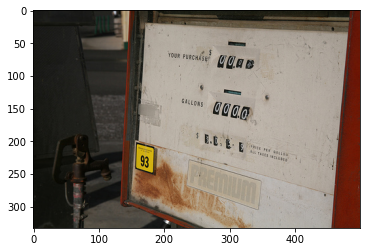

1964


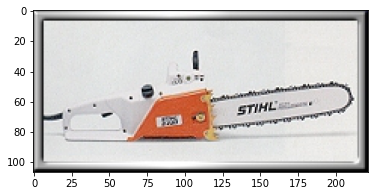

9442


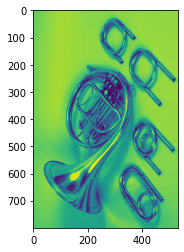

8130


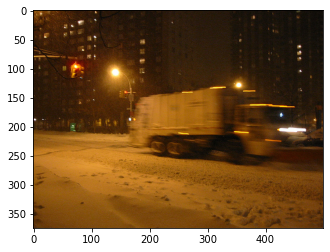

In [28]:
positives = [6453, 6076, 5792, 6407]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

As we're performing multiple training steps with a relatively high learning rate (`lr`), the model is pretty responsive and moves quickly, in this case the model likely saw the negative dog examples and pulled us away from the dog vectors. We mark all of these as negatives.

3875


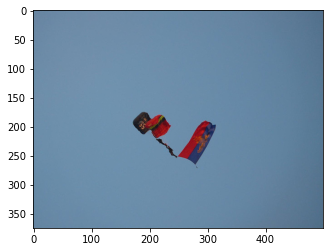

3967


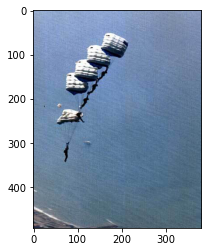

4563


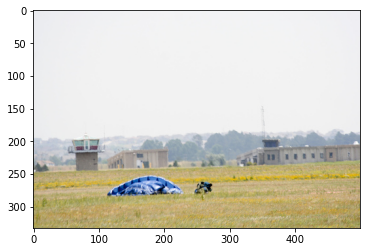

572


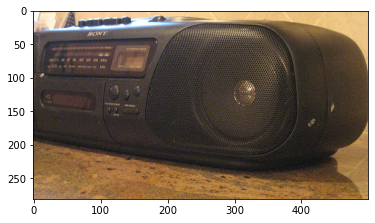

5944


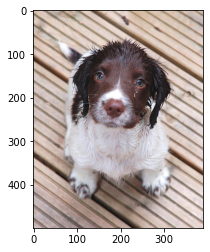

4118


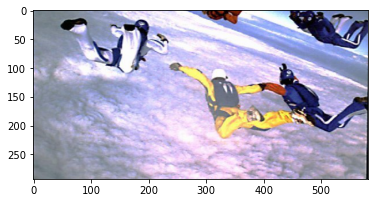

4547


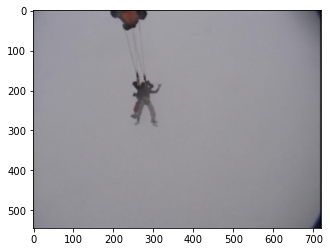

7004


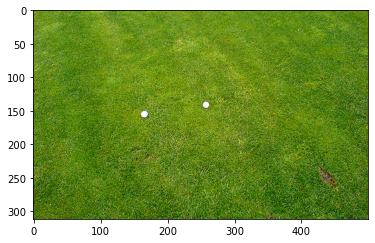

771


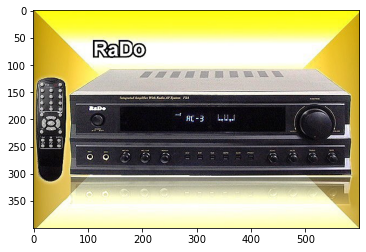

5823


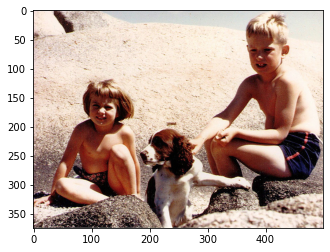

In [29]:
positives = []
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

Now we need to focus on returning to the dog vector space, so we mark all dog images as relevant.

5854


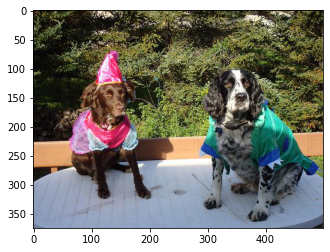

5808


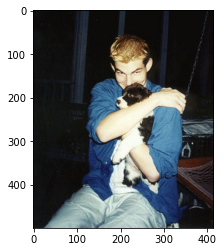

6126


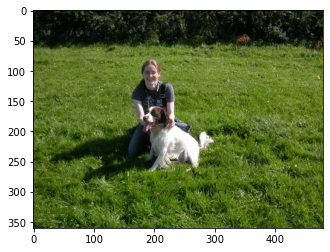

6508


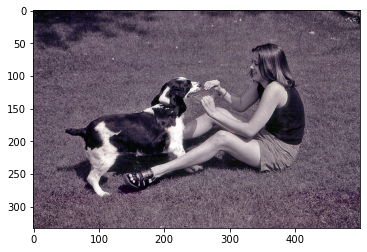

6098


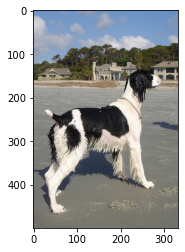

5647


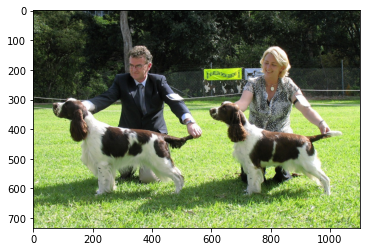

6554


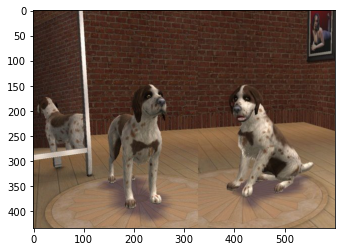

874


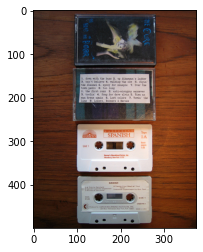

2497


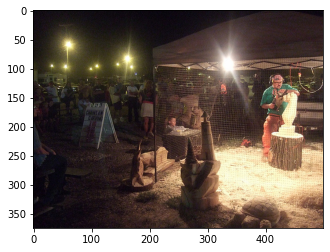

5830


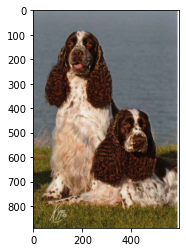

In [30]:
positives = [5944, 5823]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We do ahve one dog show image here, we'll mark that and other "dog in field" images as relevant.

6121


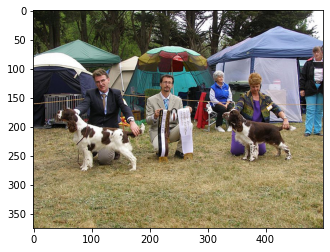

6340


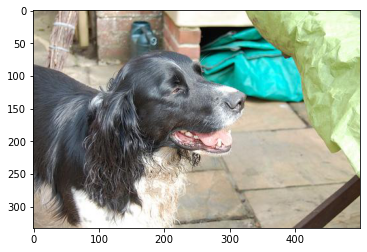

5940


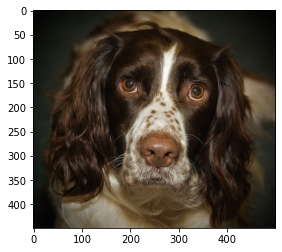

5672


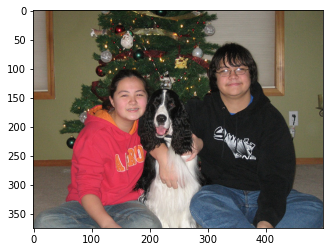

6230


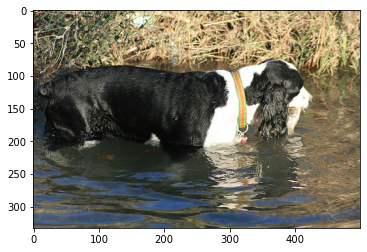

5952


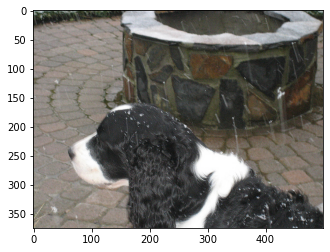

8982


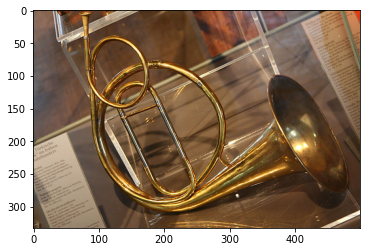

6264


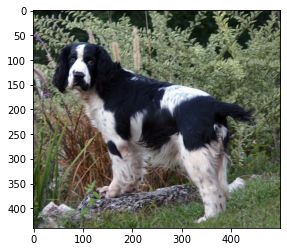

7324


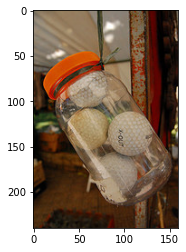

6364


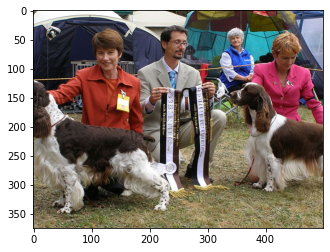

In [31]:
positives = [5854, 6126, 6508, 5647]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We're getting closer to dog show territory, we mark the two dog show images and other similar images as positives.

6210


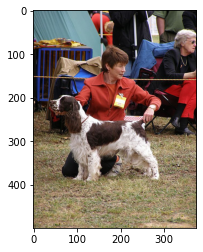

6191


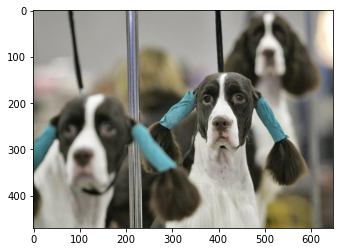

6513


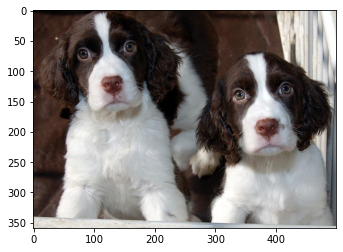

5734


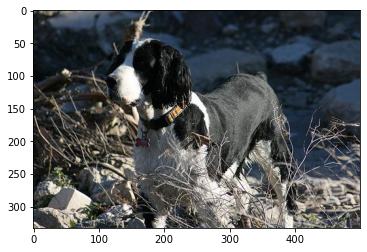

5756


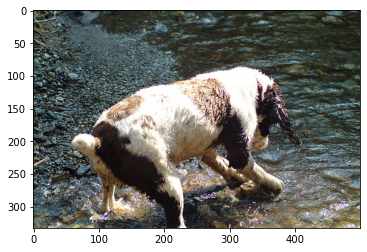

6462


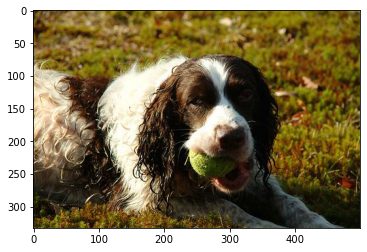

5835


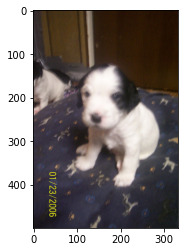

5898


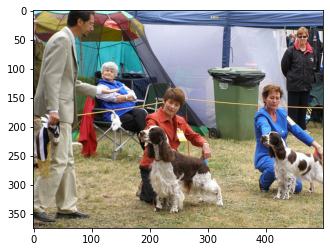

6021


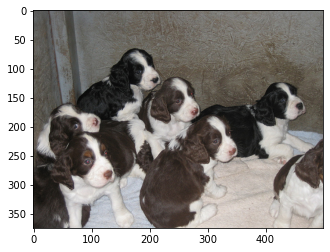

6350


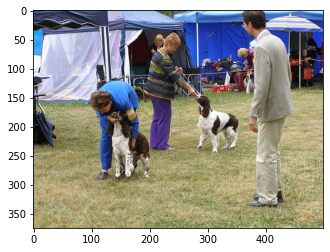

In [32]:
positives = [6121, 6340, 6264, 6364]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We're pulling in more dogs show images...

6436


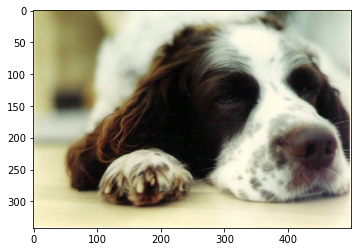

6011


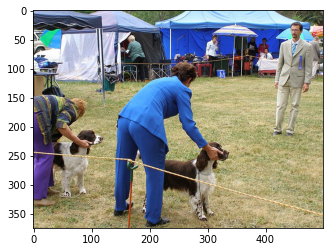

6353


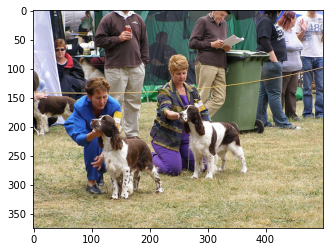

6208


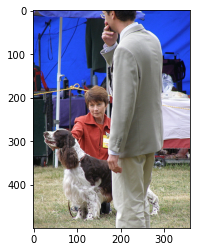

5877


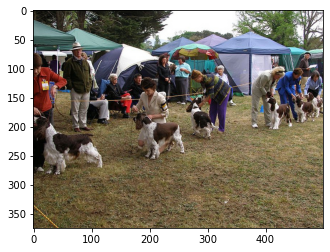

6058


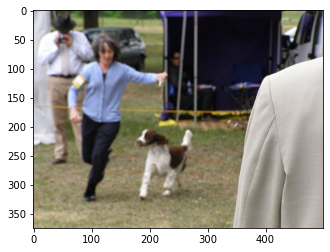

6026


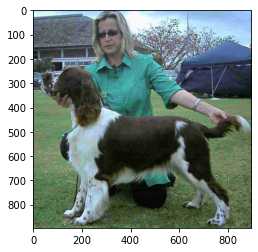

5981


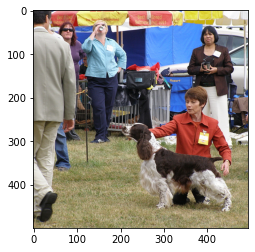

6141


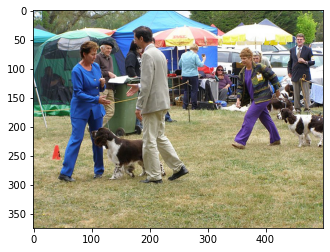

6376


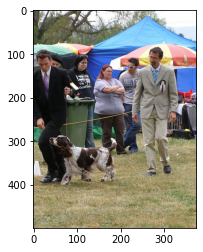

In [33]:
positives = [6210, 6191, 6462, 5898, 6350]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We're definitely in dog show territory, we'll mark a few more dog show images as relevant.

6455


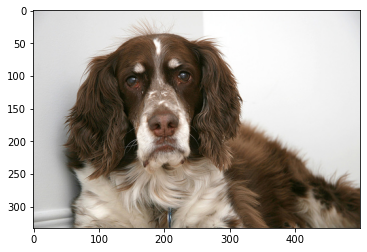

5782


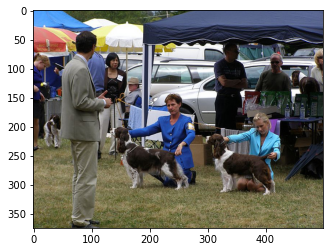

5753


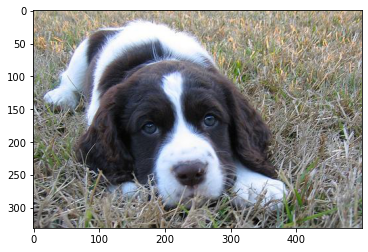

6379


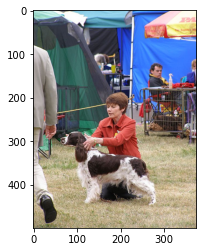

6293


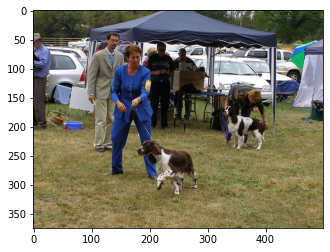

6116


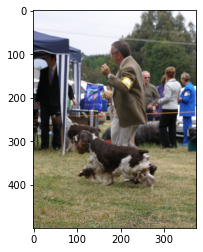

5858


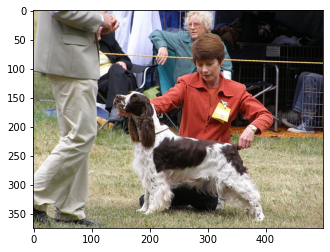

6558


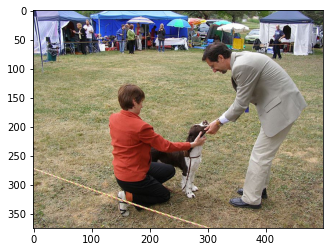

6589


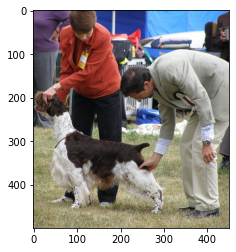

6571


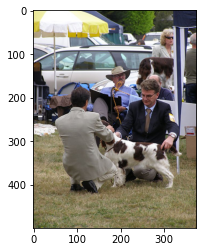

In [34]:
positives = [6011, 6353, 6208, 5877, 6058, 6026, 5981, 6141, 6376]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

6024


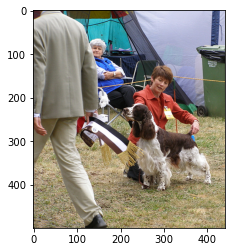

6417


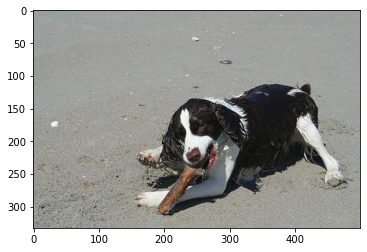

6358


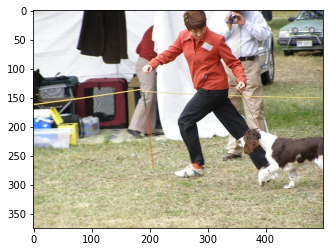

6485


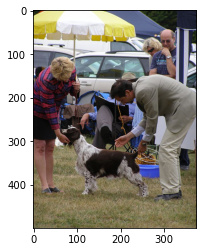

6538


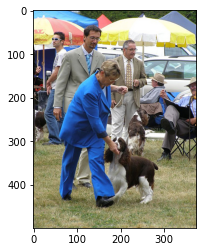

5915


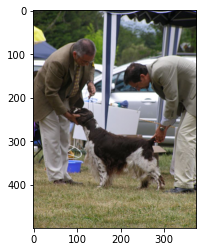

6068


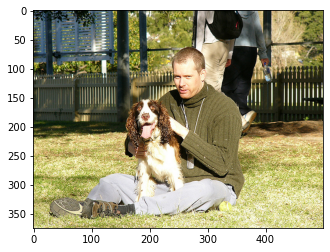

5892


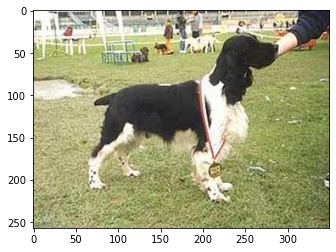

6156


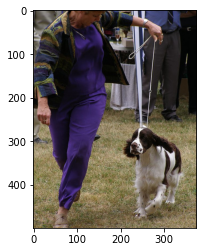

6561


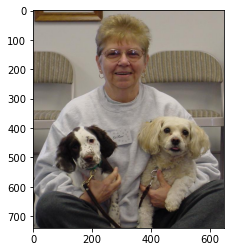

In [35]:
positives = [5782, 6379, 6293, 6116, 5858, 6558, 6589, 6571]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

Okay, we get the point - we're returning a lot of dog show pictures, our classifier weights are producing pretty good queries. We can continue training like this for a long time, we could even modify our search to look for something new. However, let's move on to searching without any filters to test the performance of our query. There are two options for searching without a filter:

* We drop the `filter` argument, this would not work if needing to perform a second iteration of training over the same data.
* We reset the filter values, switching all records where `{"seen": 1}` back to `{"seen": 0}`.

We will go ahead and take the second approach:

In [36]:
while True:
    xc = index.query(xq, top_k=100, filter={"seen": 1})
    idx = [match['id'] for match in xc['matches']]
    if len(idx) == 0: break
    for i in idx:
        index.update(str(i), set_metadata={"seen": 0})

Now if we search again, we will return a completely unfiltered view of the search results.

6121


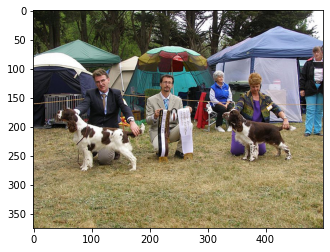

6210


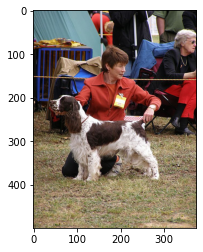

6364


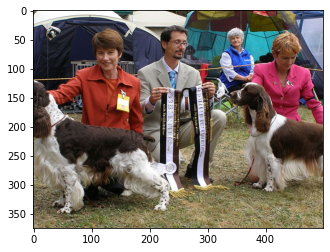

5898


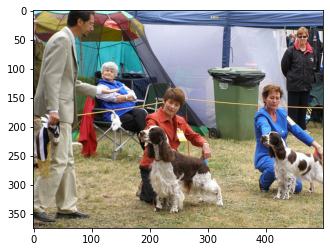

6350


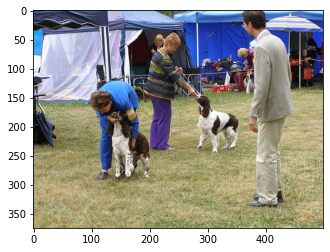

6208


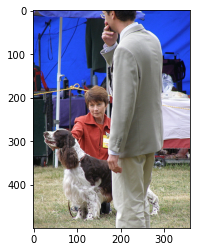

6011


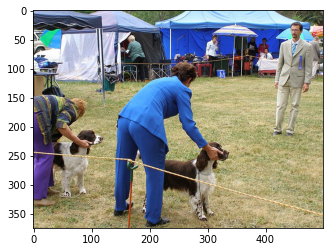

5877


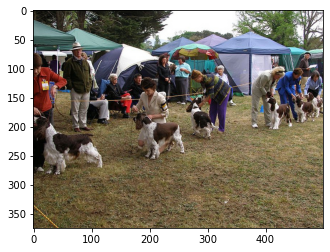

5734


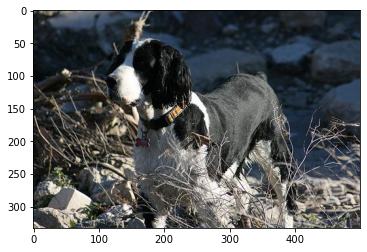

6353


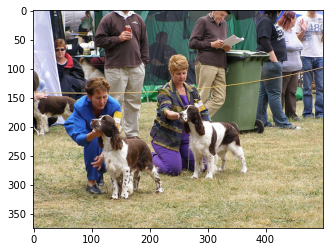

In [37]:
idx, xc = get_top_k(xq)

Plenty of dog shows!

---